# November 10th, 2019 (Tuesday) Data Analysis Notebook

In [2]:
# current date, for retrieving data from proper location.
year = "2020"
month = "November"
day = "11"

## Imports and initialization

In [3]:
import numpy as np 
from numpy import array as arr
import pandas as pd
import plotly.offline as pltly
pltly.init_notebook_mode(connected=True)
from plotly import graph_objs as go
import math
import scipy.optimize as opt
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import warnings 
warnings.filterwarnings('module')
from datetime import datetime
import uncertainties.unumpy
import IPython
import pandas as pd
import pickle

from matplotlib.pyplot import *
from matplotlib import rcParams
from matplotlib import style
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
%matplotlib inline

# ## set matplotlib plot defaults :D
# Style controls many default colors in matplotlib plots.
# Change the following if you don't like dark backgrounds. Many other options.
import matplotlib as mpl

if False:
    # My Dark Settings
    style.use(['dark_background'])
    c = '#0A0A0A'
    mpl.rcParams['axes.facecolor'] = '#000000'
    mpl.rcParams['figure.edgecolor'] = c
    mpl.rcParams['figure.facecolor'] = c
else:
    # My Light Settings
    style.use(['default'])
    c = '#FFFFFF'
    mpl.rcParams['axes.facecolor'] = c
    mpl.rcParams['figure.edgecolor'] = c
    mpl.rcParams['figure.facecolor'] = c  
# the default cycling of colors in this mode isn't very good.
#rcParams['axes.prop_cycle'] = ("cycler('color', ['r','c','g','#FFFFFF','b']) + cycler('marker', ['o','v','<','>','^'])")
### General
rcParams['figure.figsize'] = (25.0, 8.0)
rcParams['axes.grid'] = True
rcParams['axes.formatter.useoffset'] = False
rcParams['grid.alpha'] = 0.15
rcParams['axes.formatter.limits'] = (-3,3)
rcParams['image.cmap'] = 'viridis'
#rcParams['image.cmap'] = dark_viridis_cmap
# to see all available options, decomment this line.
# print(mpl.rcParams)
rcParams['font.size'] = 14
from matplotlib import cm
viridis = cm.get_cmap('viridis', 256)
dark_viridis = []
bl = 0.15
for i in range(256):
    dark_viridis.append(list(viridis(i)))
    dark_viridis[-1][0] = dark_viridis[-1][0] *(bl+(1-bl)*i/255)
    dark_viridis[-1][1] = dark_viridis[-1][1] *(bl+(1-bl)*i/255)
    dark_viridis[-1][2] = dark_viridis[-1][2] *(bl+(1-bl)*i/255)
dark_viridis_cmap = ListedColormap(dark_viridis)

In [4]:
from Analysis_Python_Files.fitters.Gaussian import dip, double_dip, bump, bump2, bump3, bump2r, gaussian
from Analysis_Python_Files.fitters.Sinc_Squared import sinc_sq3_Sym, sinc_sq
from Analysis_Python_Files.fitters import decaying_cos
from Analysis_Python_Files.fitters import linear

import Analysis_Python_Files.ExpFile as exp
from Analysis_Python_Files.ExpFile import setPath
#from VersionManagement import getVersions
import Analysis_Python_Files.PlotlyPlotters as pp
import Analysis_Python_Files.MatplotlibPlotters as mp
import Analysis_Python_Files.MainAnalysis as ma
import Analysis_Python_Files.AnalysisHelpers as ah
import Analysis_Python_Files.Miscellaneous as misc
import Analysis_Python_Files.PopulationAnalysis as pa
import Analysis_Python_Files.MarksConstants as mc
import Analysis_Python_Files.fitters as fitters
import Analysis_Python_Files.LoadingFunctions as lf
import Analysis_Python_Files.FreeSpaceImaging as fsi
import Analysis_Python_Files.TransferAnalysis as ta
import Analysis_Python_Files.LightShiftCalculations as lsc
from Analysis_Python_Files.TransferAnalysisOptions import TransferAnalysisOptions as ao
import Analysis_Python_Files.ThresholdOptions as to
import Analysis_Python_Files.TransferAnalysisOptions as tao

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

<frozen importlib._bootstrap>:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

<frozen importlib._bootstrap>:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject

<frozen importlib._bootstrap>:219: RuntimeWarning:

numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject



In [5]:
from importlib import reload
def reloadMyModules(day_=None):
    reload(exp)
    if day_ is None:
        day_ = day
    setPath(day_,month,year)
    reload(lf)
    reload(misc)
    reload(ma)
    reload(ah)
    reload(pp)
    reload(mp)
    reload(fitters)
    reload(fsi)
    reload(ta)
    reload(pa)
    reload(tao)
reloadMyModules()

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [8]:
import Analysis_Python_Files.PictureWindow as pw

## Standard Calibrations

### Temperature

#### Running Temperature

In [5]:
year_ = '2020'
times = []
temps = [[],[],[],[]]
for year_ in ['2018','2019','2020']:
    print('\n',year_)
    for month_ in ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']:
        print(month_,end=', ')
        for d in range(1,31):
            day_ = str(d)
            exp.setPath(day_,month_,year_)
            reload(ah)
            try:
                xpts, data = ah.Temperature(show=False)
                for x in xpts:
                    times.append(datetime.strptime(year_+':'+month_+':'+day_ + ':' + x, '%Y:%B:%d:%H:%M'))
                for i in range(4):
                    temps[i] += list(data[3*(i+1)])
            except FileNotFoundError:
                pass


 2018
January, February, March, April, May, June, July, August, September, October, November, December, 
 2019
January, February, March, April, May, June, July, August, September, October, November, December, 
 2020
January, February, March, April, May, June, July, August, September, October, November, December, 

In [6]:
cTemps, cTimes = [[],[]]
for i, (time, ts) in enumerate(zip(times, misc.transpose(temps))):
    bad_ = False
    for t in ts:
        try:
            x = float(t)
            if x <= 0:
                raise ValueError()
        except ValueError:
            bad_ = True
            break
    if not bad_:
        cTemps.append([float(temp) for temp in ts])
        cTimes.append(time)

C:\Users\wdwor\Miniconda3\lib\asyncio\events.py:81: DeprecationWarning:

`run_cell_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



(20.0, 30.0)

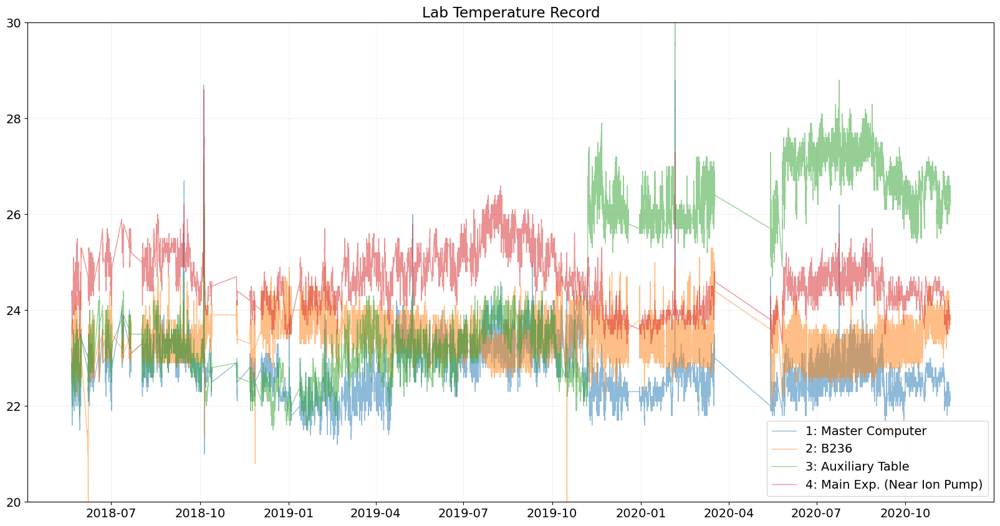

In [7]:
legends = ['1: Master Computer', '2: B236', '3: Auxiliary Table', '4: Main Exp. (Near Ion Pump)']
fig, ax = plt.subplots(figsize=(20,10))
for temp,lab in zip(misc.transpose(cTemps), legends):
    ax.plot(cTimes,temp, label=lab, alpha=0.5, linewidth=1)
ax.legend()
ax.set_title('Lab Temperature Record');
ax.set_ylim(20,30)

#### Today's Temperature

In [8]:
reload(mp)

<module 'Analysis_Python_Files.MatplotlibPlotters' from 'C:\\Users\\wdwor\\Documents\\Code\\Data-Analysis-Code\\Analysis_Python_Files\\MatplotlibPlotters.py'>

In [9]:
reloadMyModules()

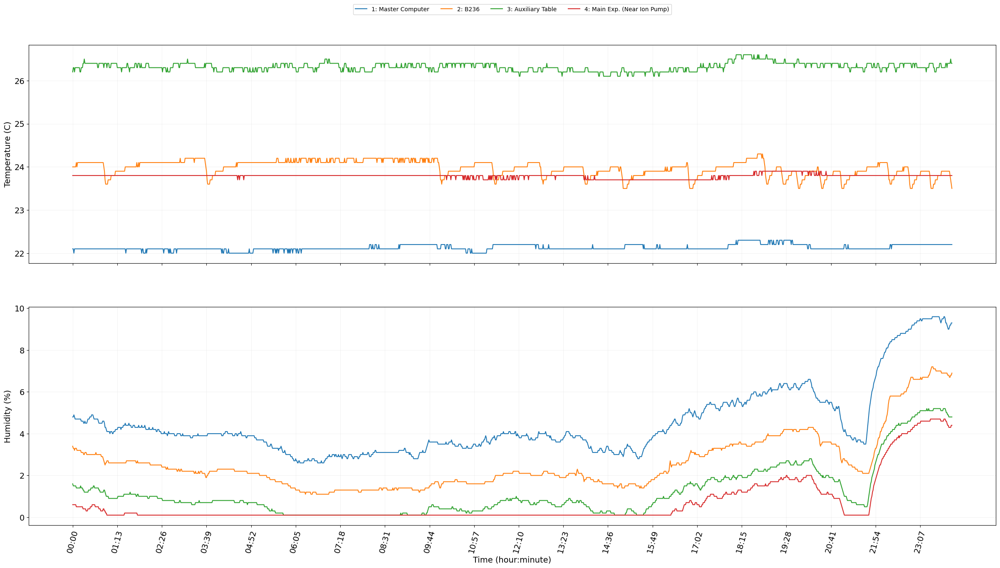

In [10]:
ah.Temperature();

### individual calibrations

In [11]:
from dataclasses import dataclass
@dataclass
class calPoint:
    value: float 
    error: np.ndarray
    timestamp: datetime

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [12]:
def getWaist_fromRadialFreq(freq_r, depth_mk):
    """
    :@param freq: the radial trap frequency in non-angular Hz.
    :@param depth: the trap depth in mK
    """
    V = mc.k_B * depth_mk * 1e-3
    omega_r = 2*np.pi*freq_r
    return np.sqrt(4*V/(mc.Rb87_M * omega_r**2))
def getWaist_fromRadialFreq_err(freq_r, depth_mk, freq_r_err, depth_mk_err):
    m = mc.Rb87_M
    omega_r = 2*np.pi*freq_r
    V = depth_mk*mc.k_B*1e-3
    t1 = np.sqrt(4/(m * omega_r**2))*depth_mk_err*mc.k_B*1e-3
    t2 = np.sqrt(8*V/(m*omega_r**3))*freq_r_err*2*np.pi
    return np.sqrt(t1**2+t2**2)

In [13]:
def getWaistFromBothFreqs(nu_r, nu_z):
    return 850e-9/(np.sqrt(2)*np.pi)*(nu_r/nu_z)

In [14]:
def getWaist_fromAxialFreq(freq_z, depth_mk):
    """
    :@param freq: the radial trap frequency in non-angular Hz.
    :@param depth: the trap depth in mK
    """
    V = mc.k_B * depth_mk * 1e-3
    omega_z = 2*np.pi*freq_z
    wavelength=850e-9
    return (2*V/mc.Rb87_M)**(1/4)*np.sqrt(wavelength /(np.pi*omega_z))

In [15]:
ea = None
sCalData = {"Loading":ea,"ImagingSurvival":ea,"MOT_Size":ea,"MOT_FillTime":ea, "MOT_Temperature":ea,
           "RPGC_Temperature":ea,"LGM_Temperature":ea,"ThermalTrapFreq":ea, "ThermalNbar":ea, 
           "AxialTrapFreq":ea, "AxialCarrierLocation":ea, "AxialNbar":ea, "RadialTrapFreq":ea,
           "RadialNbar":ea, "RadialCarrierLocation":ea, "DeepScatteringResonance":ea, "DeepDepth":ea, 
           "ShallowScatteringResonance":ea, "ShallowDepth":ea, "ResonanceDelta":ea, "SpotSize2Freqs":ea, 
           "SpotSizeRadialDepth":ea, "SpotSizeAxDepth":ea, "RamanDepth":ea, "ResonanceDepthDelta":ea }

### File BASIC_SINGLE_ATOMS (7x1_Atom_Loading_And_Imaging)

Number of Pictures: 2000; Picture Dimensions: 5 x 23
Variations: 1;	Repetitions: 1000;	Exp File Version: 4;
Experiment started at (H:M:S) 11:16:10: on (Y-M-D) 2020-11-11, And ended at 11:24:1: on 2020-11-11
Experiment Notes: HDF5 NOT ANNOTATED: please call exp.Annotate() to annotate this file.



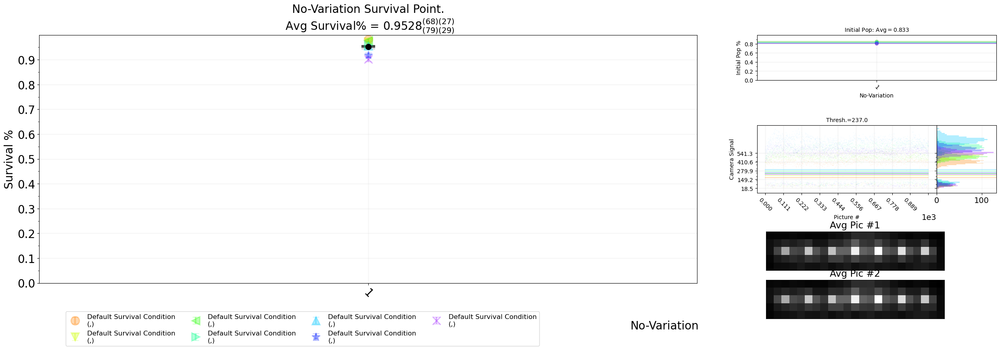

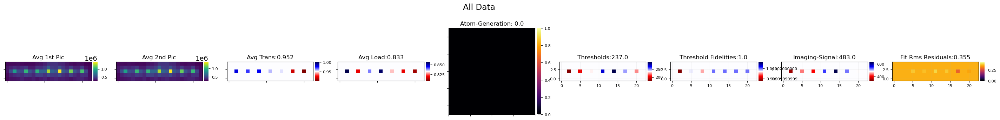

In [16]:
res = mp.Survival("BASIC_SINGLE_ATOMS", [2,2,3,7,1], forceNoAnnotation=True);
dt = exp.getStartDatetime("BASIC_SINGLE_ATOMS")
#sCalData['Loading'] = calPoint(np.mean(res['Initial_Populations']), np.std(res['Initial_Populations']),dt)
avgVals = [np.mean(vals) for vals in misc.transpose(res['Initial_Populations'])]
sCalData['Loading'] = calPoint(np.max(avgVals), np.std(misc.transpose(res['Initial_Populations'])[np.argmax(avgVals)]),dt)
sCalData['ImagingSurvival'] = calPoint(res['Average_Transfer'][0],res['Average_Transfer_Err'][0],dt)

In [18]:
reload(mp)

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



<module 'Analysis_Python_Files.MatplotlibPlotters' from 'C:\\Users\\wdwor\\Documents\\Code\\Data-Analysis-Code\\Analysis_Python_Files\\MatplotlibPlotters.py'>

In [20]:
mp.test()

AttributeError: module 'Analysis_Python_Files.MatplotlibPlotters' has no attribute 'test'

In [21]:
mp

<module 'Analysis_Python_Files.MatplotlibPlotters' from 'C:\\Users\\wdwor\\Documents\\Code\\Data-Analysis-Code\\Analysis_Python_Files\\MatplotlibPlotters.py'>

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



ValueError: 'bottom' is not a valid value for origin; supported values are 'upper', 'lower'

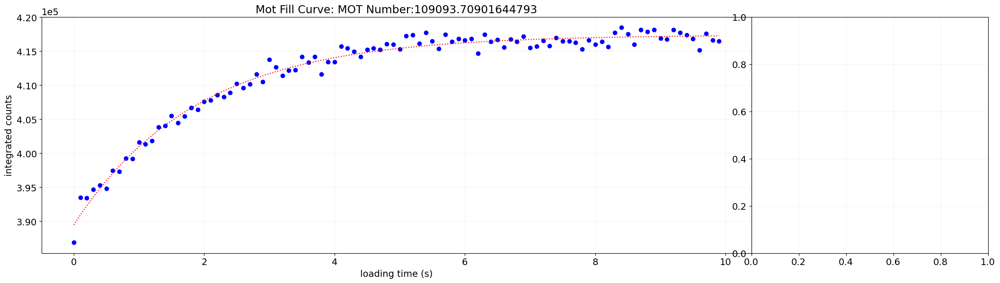

In [17]:
res = mp.plotMotNumberAnalysis('MOT_NUMBER', motKey=np.arange(0,10,0.1), exposureTime=2e-3);
dt = exp.getStartDatetime("MOT_NUMBER")
sCalData['MOT_Size'] = calPoint(res[0], 0, dt)
sCalData['MOT_FillTime'] = calPoint(res[1], res[3], dt)

In [ ]:
res = mp.plotMotTemperature('MOT_TEMPERATURE', reps=15, fitWidthGuess=15);
dt = exp.getStartDatetime("MOT_TEMPERATURE")
sCalData['MOT_Temperature'] = calPoint(res[-2],res[-1],dt) 

In [ ]:
res = mp.plotMotTemperature('RED_PGC_TEMPERATURE', reps=15, fitWidthGuess=15);
dt = exp.getStartDatetime("RED_PGC_TEMPERATURE")
sCalData['RPGC_Temperature'] = calPoint(res[-2],res[-1],dt) 

In [ ]:
res = mp.plotMotTemperature('GREY_MOLASSES_TEMPERATURE', reps=15, fitWidthGuess=15, lastDataIsBackground=True);
dt = exp.getStartDatetime("GREY_MOLASSES_TEMPERATURE")
sCalData['LGM_Temperature'] = calPoint(res[-2], res[-1], dt) 

In [ ]:
res = mp.Survival( "3DSBC_TOP_CARRIER_RAMAN_SPECTROSCOPY", [2,2,3,7,1], fitModules=[sinc_sq], forceNoAnnotation=True);
dt = exp.getStartDatetime("3DSBC_TOP_CARRIER_RAMAN_SPECTROSCOPY")
fit = res['Average_Transfer_Fit']
sCalData['RadialCarrierLocation'] = calPoint(fit['vals'][1], fit['errs'][1], dt) 

In [ ]:
res = mp.Survival( "THERMAL_TOP_SIDEBAND_RAMAN_SPECTROSCOPY", [2,2,3,7,1], 
                   forceNoAnnotation=True, fitModules=[bump2], 
                   fitguess=[[0,0.3,-150,10, 0.3, 150, 10]]);
dt = exp.getStartDatetime("THERMAL_TOP_SIDEBAND_RAMAN_SPECTROSCOPY")
fit = res['Average_Transfer_Fit']
sCalData['ThermalTrapFreq'] = calPoint((fit['vals'][-2] - fit['vals'][2]) / 2, np.sqrt(fit['errs'][-2]**2/4+fit['errs'][2]**2/4), dt) 
sCalData['ThermalNbar'] = calPoint(bump2.fitCharacter(fit['vals']), bump2.fitCharacterErr(fit['vals'], fit['errs']), dt)

In [ ]:
res = mp.Survival( "3DSBC_AXIAL_RAMAN_SPECTROSCOPY", [2,2,3,7,1], forceNoAnnotation=True, 
                   fitModules=[sinc_sq3_Sym], fitguess=sinc_sq3_Sym.sbcGuess(),
                   showFitDetails=False );
dt = exp.getStartDatetime("3DSBC_AXIAL_RAMAN_SPECTROSCOPY")
fitV = res['Average_Transfer_Fit']['vals']
fitE = res['Average_Transfer_Fit']['errs']
sCalData['AxialTrapFreq'] = calPoint(fitV[-2]/2, fitE[-2]/2, dt) 
sCalData['AxialCarrierLocation'] = calPoint(fitV[-3], fitE[-3], dt) 
sCalData['AxialNbar'] = calPoint(sinc_sq3_Sym.fitCharacter(fitV), sinc_sq3_Sym.fitCharacterErr(fitV, fitE), dt)

In [ ]:
res = mp.Survival("3DSBC_TOP_SIDEBAND_RAMAN_SPECTROSCOPY", [2,2,3,7,1], 
                  fitModules=[bump2], fitguess=[[0,0.3,-150,10, 0.3, 150, 10]], forceNoAnnotation=True);
dt = exp.getStartDatetime("3DSBC_TOP_SIDEBAND_RAMAN_SPECTROSCOPY")
fvals = res['Average_Transfer_Fit']['vals']
ferrs = res['Average_Transfer_Fit']['errs']
sCalData['RadialTrapFreq'] = calPoint((fvals[-2]-fvals[2])/2, np.sqrt(ferrs[-2]**2/4+ferrs[2]**2/4), dt) 
sCalData['RadialNbar'] = calPoint(bump2.fitCharacter(fvals), bump2.fitCharacterErr(fvals, ferrs), dt) 
if sCalData["AxialTrapFreq"] is not None:
    nur = sCalData["RadialTrapFreq"].value
    nuax = sCalData["AxialTrapFreq"].value
    sCalData["SpotSize2Freqs"] = calPoint(getWaistFromBothFreqs(nur,nuax), 0, dt)

In [ ]:
res = mp.Survival("DEPTH_MEASUREMENT_DEEP", [2,2,3,7,1], fitModules=dip, forceNoAnnotation=True, showFitDetails=True);
dt = exp.getStartDatetime("DEPTH_MEASUREMENT_DEEP")
fvals = res['Average_Transfer_Fit']['vals']
ferrs = res['Average_Transfer_Fit']['errs']
sCalData['DeepScatteringResonance'] = calPoint(fvals[1], ferrs[1], dt) 
rdepth = lsc.trapDepthFromDac(sCalData['DeepScatteringResonance'].value)
sCalData['DeepDepth'] = calPoint(rdepth, abs(rdepth-lsc.trapDepthFromDac(sCalData['DeepScatteringResonance'].value+sCalData['DeepScatteringResonance'].error)), dt) 
sCalData['RamanDepth'] = sCalData['DeepDepth']
if sCalData["RadialTrapFreq"] is not None:
    sCalData['SpotSizeRadialDepth'] = calPoint(getWaist_fromRadialFreq(sCalData["RadialTrapFreq"].value*1e3, -rdepth ),
                                               getWaist_fromRadialFreq_err(sCalData["RadialTrapFreq"].value*1e3, 
                                                                           -rdepth, sCalData["RadialTrapFreq"].error*1e3, sCalData['RamanDepth'].error) ,dt)
if sCalData["AxialTrapFreq"] is not None:
    sCalData['SpotSizeAxDepth'] = calPoint(getWaist_fromAxialFreq(sCalData["AxialTrapFreq"].value*1e3, -sCalData['RamanDepth'].value ),0,dt)
sCalData['IndvDeepScatteringResonances'] = [None for _ in res['Transfer_Fits']]
sCalData['IndvRamanDepths'] = [None for _ in res['Transfer_Fits']]
for fitn, fit in enumerate(res['Transfer_Fits']):
    fvals = fit['vals']
    ferrs = fit['errs']
    res = calPoint(fvals[1], ferrs[1], dt) 
    sCalData['IndvDeepScatteringResonances'][fitn] = res
    rdepth = lsc.trapDepthFromDac(res.value)
    sCalData['IndvRamanDepths'][fitn] = calPoint(rdepth, abs(rdepth-lsc.trapDepthFromDac(res.value+res.error)), dt)


In [ ]:
res = mp.Survival("DEPTH_MEASUREMENT_SHALLOW", [2,2,3,7,1], fitModules=dip, forceNoAnnotation=True);
dt = exp.getStartDatetime("DEPTH_MEASUREMENT_SHALLOW")
fvals = res['Average_Transfer_Fit']['vals']
ferrs = res['Average_Transfer_Fit']['errs']
sCalData['ShallowScatteringResonance'] = calPoint(fvals[1], ferrs[1], dt)
# bit of a cheap error calculation here
sCalData['ShallowDepth'] = calPoint(lsc.trapDepthFromDac(sCalData['ShallowScatteringResonance'].value),
                                    abs(lsc.trapDepthFromDac(sCalData['ShallowScatteringResonance'].value)
                                        -lsc.trapDepthFromDac(sCalData['ShallowScatteringResonance'].value+sCalData['ShallowScatteringResonance'].error)), 
                                    dt) 
if sCalData['DeepScatteringResonance'] is not None:
    sCalData['ResonanceDelta'] = calPoint(sCalData['DeepScatteringResonance'].value - sCalData['ShallowScatteringResonance'].value, 
                                          np.sqrt(sCalData['DeepScatteringResonance'].error**2+sCalData['ShallowScatteringResonance'].error**2), dt)
    sCalData['ResonanceDepthDelta'] = calPoint( sCalData['DeepDepth'].value-sCalData['ShallowDepth'].value, 
                                                np.sqrt(sCalData['DeepDepth'].error**2+sCalData['ShallowDepth'].error**2), dt)

In [ ]:
with open(exp.dataAddress + 'CalibrationData.p','wb') as calFile:
    pickle.dump(sCalData, calFile)

In [ ]:
reloadMyModules()

## Calibration Summmary

In [ ]:
def plotCalData(ax, dataV, pltargs={}, sf=1):
    err = np.array(np.array([data.error for data in dataV]).tolist())
    if len(np.array(err).shape) == 2:
        err = misc.transpose(err)
    ax.errorbar([data.timestamp for data in dataV], [data.value*sf for data in dataV], 
                yerr=err, **pltargs)

In [ ]:
def addAnnotations(ax):
    ax.axvline(datetime(2020,6,20), color='k')
    ax.text(datetime(2020,6,20),0.5, 'Chimera 2.0', transform=ax.get_xaxis_transform(), color='k')
    ax.axvline(datetime(2020,7,11), color='k')
    ax.text(datetime(2020,7,11), 0.5, "Mark's Vacation", transform=ax.get_xaxis_transform(), color='k')
    ax.axvline(datetime(2020,7,21), color='k')
    ax.text(datetime(2020,7,21), 0.5, "Changed to 7 Atoms", transform=ax.get_xaxis_transform(), color='k')
    ax.axvline(datetime(2020,9,21), color='k')
    ax.text(datetime(2020,9,21), 0.5, "Sprout Issues;\nSwitch To TA", transform=ax.get_xaxis_transform(), color='k')

def setAxis(ax, dataV=None, color='r', pad=0):
    ax.spines['right'].set_color(color)
    ax.yaxis.label.set_color(color)
    ax.tick_params(axis='y', colors=color)
    ax.tick_params(axis='y', which='major', pad=pad)
    ax.tick_params(axis='x', rotation=45)
    ax.grid(alpha=0.15)
    ax.xaxis.set_major_locator(mdates.DayLocator(interval=3))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%b-%d'))
    addAnnotations(ax)

def makeLegend(ax, loc = 'upper left', bbox=(0,1.05)):
    leg = ax.legend(loc=loc, bbox_to_anchor=bbox, ncol=3, framealpha=1)
    for text in leg.get_texts():
        text.set_color("k")

In [ ]:
# load all past calibration data into a bigger strucutre.
ea = np.array([])
calData = {"Loading":ea,"ImagingSurvival":ea,"MOT_Size":ea,"MOT_FillTime":ea, "MOT_Temperature":ea,
           "RPGC_Temperature":ea,"LGM_Temperature":ea,"ThermalTrapFreq":ea, "ThermalNbar":ea, 
           "AxialTrapFreq":ea, "AxialCarrierLocation":ea, "AxialNbar":ea, "RadialTrapFreq":ea,
           "RadialNbar":ea, "RadialCarrierLocation":ea, "DeepScatteringResonance":ea, "DeepDepth":ea, 
           "ShallowScatteringResonance":ea, "ShallowDepth":ea, "ResonanceDelta":ea, "SpotSize2Freqs":ea, 
           "SpotSizeRadialDepth":ea, "SpotSizeAxDepth":ea, "RamanDepth":ea, "ResonanceDepthDelta":ea, "IndvRamanDepths":ea }
for month in ['june', 'july', 'august', 'september', 'october', 'november','december']:
    for d in range(1,32):
        IPython.display.clear_output(wait=True)
        reloadMyModules(day_=str(d))
        try:
            with open(exp.dataAddress + 'CalibrationData.p', 'rb') as handle:
                readCalData = pickle.loads(handle.read())
            for key in calData.keys():
                if key in readCalData:
                    if readCalData[key] is not None:
                        # the data gets set to none if, e.g. there's a bad calibation set which was never fixed that day. 
                        calData[key] = np.append(calData[key], readCalData[key])
        except OSError:
            pass
reloadMyModules(day_=day)

In [ ]:
matplotlib.style.use('default')
fs = 20
fig, axs = plt.subplots(7,1, figsize=(30,50))

# ###################################
# ###################################
motAx = axs[0]
motAx_2 = motAx.twinx()
motAx_3 = motAx.twinx()
plotCalData(motAx, calData['MOT_Temperature'], {'marker':'o','label':'MOT_Temperature','capsize':5, 'color':'r'})
plotCalData(motAx_2, calData['MOT_FillTime'], {'marker':'o','label':'MOT_FillTime','capsize':5, 'color':'b'})
plotCalData(motAx_3, calData['MOT_Size'], {'marker':'o','label':'MOT_Size','capsize':5, 'color':'g'})
motAx_2.set_title('MOT Characteristics', color='k', fontsize=fs)
motAx.set_ylabel(r'MOT Temperature ($\mu K$)', fontsize=fs)
motAx_2.set_ylabel(r'MOT Fill-Time', fontsize=fs)
motAx_3.set_ylabel(r'MOT Size', fontsize=fs)
makeLegend(motAx)
makeLegend(motAx_2, 'upper right', (1,1.08))
makeLegend(motAx_3, 'upper right', (1,1.15))
motAx.set_ylabel(r'MOT Temperature ($\mu K$)', fontsize=fs)
motAx_2.set_ylabel(r'MOT Fill Time (Seconds)', fontsize=fs)
motAx_3.set_ylabel(r'MOT Size (# Atoms)', fontsize=fs)
setAxis(motAx, calData['MOT_Temperature'], color='r', pad=0)
setAxis(motAx_2, color='b', pad=0)
setAxis(motAx_3, color='g', pad=50)
# ###################################
# ###################################
ax2 = axs[1]
ax2_MOT = ax2.twinx()
plotCalData(ax2_MOT, calData['MOT_Temperature'], {'marker':'o','label':'MOT_Temperature','capsize':5, 'color':'r'})
plotCalData(ax2, calData['RPGC_Temperature'], {'marker':'o','label':'RPGC_Temperature','capsize':5, 'color':'b'})
plotCalData(ax2, calData['LGM_Temperature'], {'marker':'o','label':'LGM_Temperature','capsize':5, 'color':'g'})
makeLegend(ax2)
makeLegend(ax2_MOT, 'upper right', (1,1.05))
setAxis(ax2, color='k')
setAxis(ax2_MOT)
ax2.set_title("Free Spacing Cooling Techniques", fontsize=fs)
ax2_MOT.set_ylabel(r'MOT Temperature ($\mu K$)', fontsize=fs)
ax2.set_ylabel(r'PGC Temperature ($\mu K$)', fontsize=fs)
# ###################################
# ###################################
ax3 = axs[2]
ax3.set_title('Basic Atom', color='k', fontsize=fs)
plotCalData(ax3, calData['Loading'], {'marker':'o','label':'Loading','capsize':5})
plotCalData(ax3, calData['ImagingSurvival'], {'marker':'o','label':'ImagingSurvival','capsize':5})
ax3.set_ylim(0,1)
setAxis(ax3)
makeLegend(ax3)
# ###################################
# ###################################
trapAx_rfreqs = axs[3]
trapAx_axfreqs = trapAx_rfreqs.twinx()
plotCalData(trapAx_rfreqs, calData['ThermalTrapFreq'], {'linestyle':':','marker':'o','label':'ThermalTrapFreq','capsize':5, 'color':'r'})
plotCalData(trapAx_rfreqs, calData['RadialTrapFreq'], {'marker':'o','label':'RadialTrapFreq','capsize':5, 'color':'b'})
plotCalData(trapAx_axfreqs, calData['AxialTrapFreq'], {'marker':'o','label':'AxialTrapFreq','capsize':5, 'color':'c'})

trapAx_rfreqs.set_ylabel('Radial Trap Frequencies', fontsize=fs)
trapAx_axfreqs.set_ylabel('Axial Trap Frequencies', fontsize=fs)

trapAx_rfreqs.set_ylim(120,170)
trapAx_axfreqs.set_ylim(25,40)

makeLegend(trapAx_rfreqs, 'upper right', (1, 1.1))
makeLegend(trapAx_axfreqs, 'upper right', (1,1.2))
setAxis(trapAx_rfreqs, color='b')
setAxis(trapAx_axfreqs, color='c', pad=100)

# ###################################
# ###################################

trapAx_depths = axs[4]
trapAx_resonances = trapAx_depths.twinx()
trapAx_sizes = trapAx_depths.twinx()

plotCalData(trapAx_depths, calData['ShallowDepth'], {'linestyle':':','marker':'o','label':'ShallowDepth','capsize':5, 'color':'g'})
plotCalData(trapAx_depths, calData['DeepDepth'], {'linestyle':'--','marker':'o','label':'DeepDepth','capsize':5, 'color':'g'})
plotCalData(trapAx_depths, calData['RamanDepth'], {'linestyle':'-','marker':'o','label':'RamanDepth','capsize':5, 'color':'g'})

plotCalData(trapAx_sizes, calData['SpotSize2Freqs'],{'linestyle':':','marker':'o','label':'SpotSize2Freqs','capsize':5, 'color':'r'}, sf=1e9)
plotCalData(trapAx_sizes, calData['SpotSizeRadialDepth'],{'linestyle':'-','marker':'o','label':'SpotSizeRadialDepth','capsize':5, 'color':'r'}, sf=1e9)
plotCalData(trapAx_sizes, calData['SpotSizeAxDepth'],{'linestyle':'--','marker':'o','label':'SpotSizeAxDepth','capsize':5, 'color':'r'}, sf=1e9)

plotCalData(trapAx_resonances, calData['ResonanceDepthDelta'], {'marker':'o','label':'ResonanceDelta','capsize':5, 'color':'k'})

trapAx_sizes.set_ylabel('Spot Sizes (nm)', fontsize=fs)
trapAx_depths.set_ylabel('Depth (V)', fontsize=fs)
trapAx_resonances.set_ylabel('Depth Delta (V)', fontsize=fs)
trapAx_resonances.yaxis.tick_left()
trapAx_resonances.yaxis.set_label_position("left")
trapAx_resonances.set_ylim(-1.5,0)
trapAx_depths.set_title('Trap Characterization', color='k', fontsize=fs)

makeLegend(trapAx_resonances, 'upper left', (0,1.1))

setAxis(trapAx_resonances, color='k', pad=50)
setAxis(trapAx_sizes, color='r', pad=50)
setAxis(trapAx_depths, color='g')

makeLegend(trapAx_sizes, 'upper right', (1,1.15))
makeLegend(trapAx_depths, 'upper left', (0,1.15))
# ###################################
# ###################################
ax = axs[5]
ax.set_title('NBar Values', color='k', fontsize=fs)
plotCalData(ax, calData['ThermalNbar'], {'marker':'o','label':'ThermalNbar','capsize':5})
plotCalData(ax, calData['AxialNbar'], {'marker':'o','label':'AxialNbar','capsize':5})
plotCalData(ax, calData['RadialNbar'], {'marker':'o','label':'RadialNbar','capsize':5})
ax.set_ylim(0,2)
makeLegend(ax)
setAxis(ax)
# ###################################
# ###################################
carrierAx = axs[6]
carrierAx.set_title('Carrier Drift', color='k', fontsize=fs)
plotCalData(carrierAx, calData['RadialCarrierLocation'], {'marker':'o','label':'Radial Carrier Location','capsize':5})

setAxis(carrierAx, color='k')
makeLegend(carrierAx, loc="upper right", bbox=(1,1.05))
matplotlib.style.use('default')
carrierAx.axvline(datetime(2020,6,16))
carrierAx.text(datetime(2020,6,16),0.5, 'Started Recording\nAbosolute Freq', transform=carrierAx.get_xaxis_transform(), color='k');
display(carrierAx);

#### indv depth analysis

In [ ]:
ramanDepthData = []
for month in ['June', 'july', 'august', 'september', 'october', 'november', 'december']:
    for d in range(1,31):
        IPython.display.clear_output(wait=True)
        reloadMyModules(day_=str(d))
        try:
            with open(exp.dataAddress + 'CalibrationData.p', 'rb') as handle:
                readCalData = pickle.loads(handle.read())
            if "IndvRamanDepths" in readCalData:
                ramanDepthData.append(readCalData["IndvRamanDepths"])
        except OSError:
            pass
reloadMyModules(day_=day)

In [ ]:
fig, ax = plt.subplots(figsize=(15,5))
colors, _ = misc.getColors(11, cmStr='Oranges')
for atomNum in range(11):
    vals, dates, errs, = [],[],[]
    color = colors[atomNum]
    for dsNum in range(len(ramanDepthData)):
        if len(ramanDepthData[dsNum]) > atomNum:
            vals.append(ramanDepthData[dsNum][atomNum].value)
            dates.append(ramanDepthData[dsNum][atomNum].timestamp)
            errs.append(ramanDepthData[dsNum][atomNum].error)
    ax.errorbar(dates, vals, yerr=errs, color=color, capsize=5, marker='o', linestyle='', label='Tweezer #' + str(atomNum))

#vals = [np.mean([ds[atomNum].value for atomNum in range(len(ds))]) for ds in ramanDepthData]
#dates = [ds[atomNum].timestamp for ds in ramanDepthData]
#ax.plot(dates, vals, color='r',marker='o', markersize=6,zorder=10, label='Average Depth')
#errs = [ds[atomNum].error for ds in ramanDepthData]    

setAxis(ax, color='w')
#ax.axvline(datetime(2020,6,20), color='k')
#ax.text(datetime(2020,6,20),0.2, ' Chimera 2.0\n Installed', transform=ax.get_xaxis_transform(), color='k')
ax.axvline(datetime(2020,6,18), color='k')
ax.text(datetime(2020,6,18),0.2, ' Recalibrated\n Depths', transform=ax.get_xaxis_transform(), color='k', fontsize=10)
ax.set_ylabel('Depth (mK)')
ax.set_xlabel('Calibration Time')

ax.legend(ncol=4)

# Today's Work

In [6]:
reloadMyModules(day_='17')

Opening Basler Images.

Temperture in the Large Laser Beam Approximation (2D Fits): 205(17) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 259(27) uK
Fit-Parameters: [0.00074969 0.00015199 0.00020502]


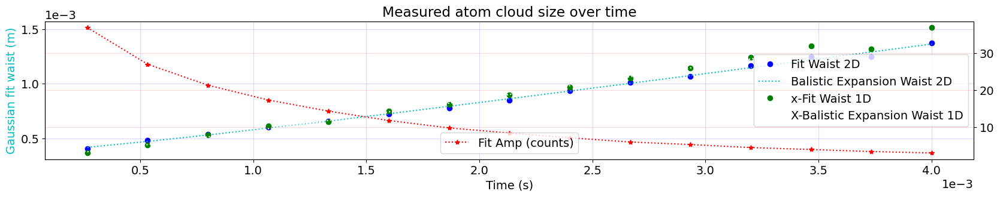

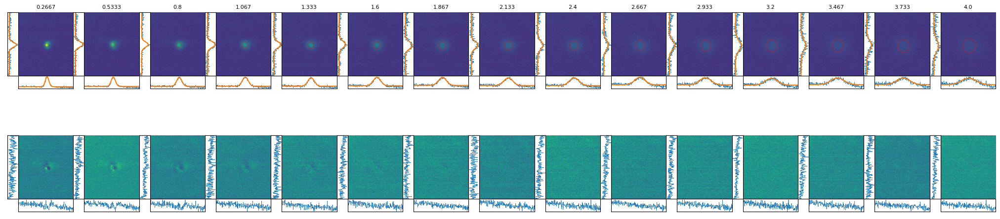

In [8]:
res = mp.plotMotTemperature(2, reps=3, fitWidthGuess=15)

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:514: UserWarning:

Vertical Average Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt




Temperture in the Large Laser Beam Approximation (2D Fits): 0(2700) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(2800000) uK
Fit-Parameters: [-1.35752068e-03  6.27232169e-04  1.02145164e-10]


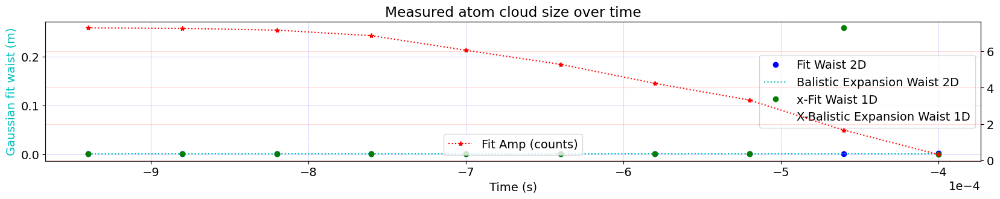

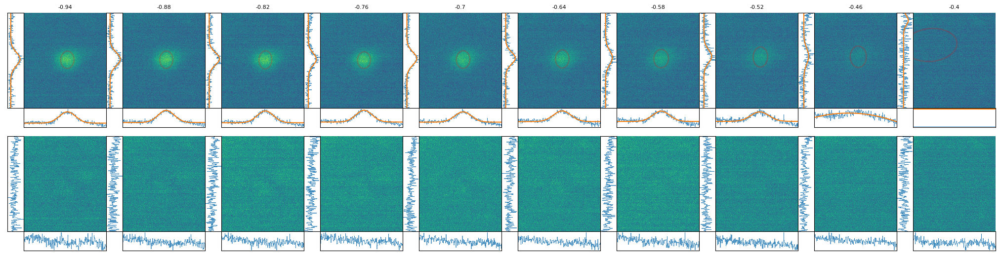

In [9]:
res = mp.plotMotTemperature(3, reps=3, fitWidthGuess=15)

In [12]:
reloadMyModules(day_='19')

In [10]:
with exp.ExpFile() as file:
    file.open_hdf5(2)
    print(file.get_experiment_time_and_date())

('2020-11-17', '12:27:35:', '2020-11-17', '12:29:15:')


Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:514: UserWarning:

Vertical Average Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:527: UserWarning:

Horizontal Average Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:536: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt




Temperture in the Large Laser Beam Approximation (2D Fits): 160(130) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(12000000) uK
Fit-Parameters: [0.0014378  0.00088541 0.00016158]


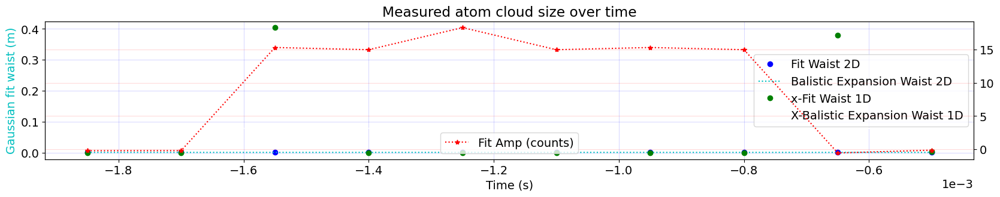

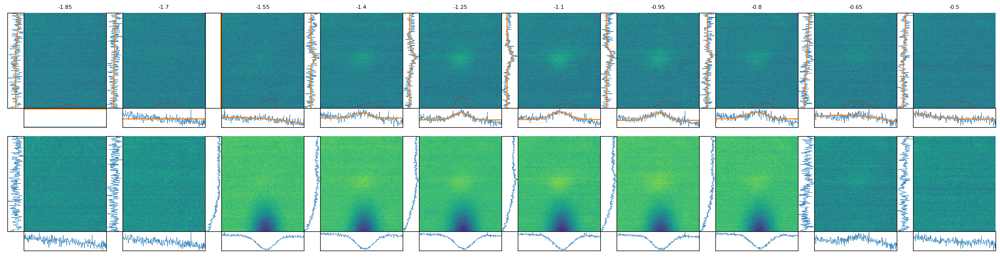

In [13]:
res = mp.plotMotTemperature(2, reps=3, fitWidthGuess=15)

In [5]:
import Analysis_Python_Files.PictureWindow as pw

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


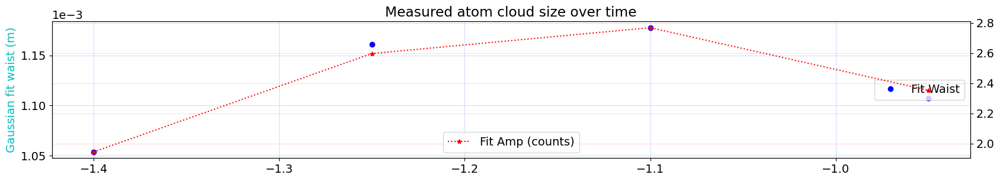

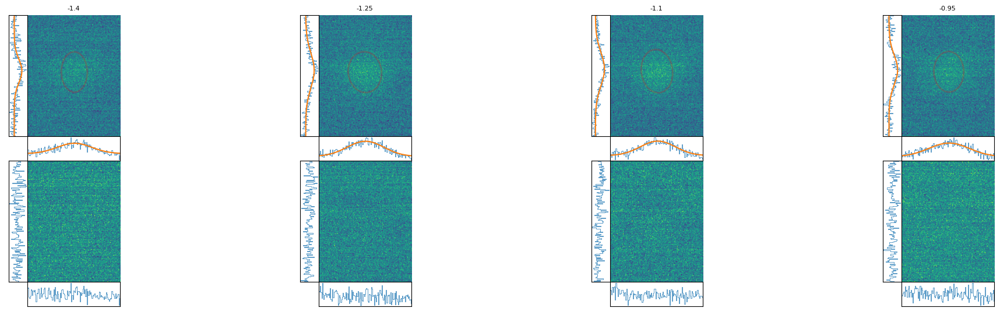

In [22]:
res = mp.plotImages(2, reps=3, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60),
                   dataRange=[3,4,5,6,7]);

In [24]:
reloadMyModules(day_='19')

Opening Basler Images.


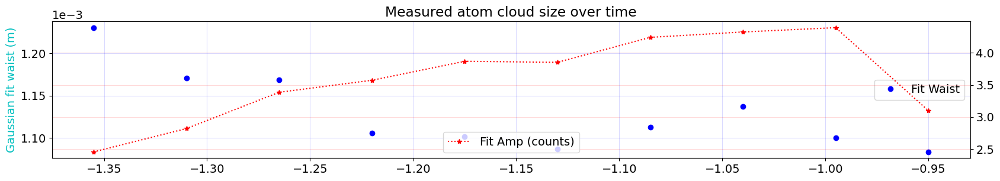

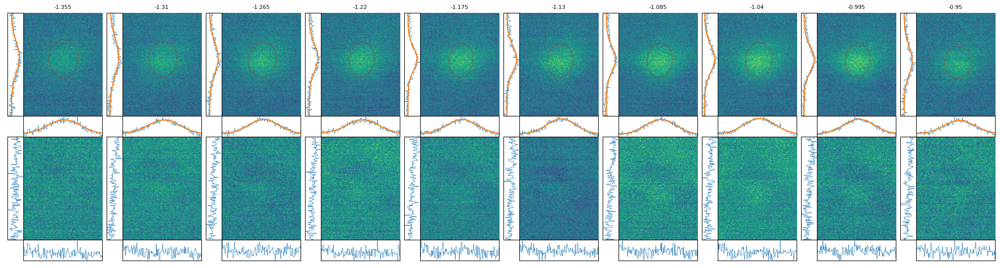

In [25]:
res = mp.plotImages(3, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

In [ ]:
ma.standardImages

#### scanning MOT freq

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


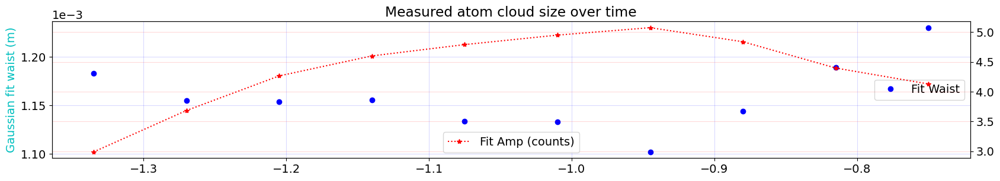

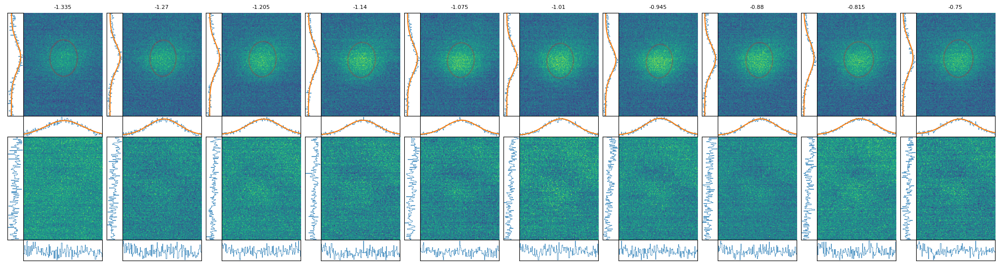

In [27]:
res = mp.plotImages(4, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### scanning repump freq

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


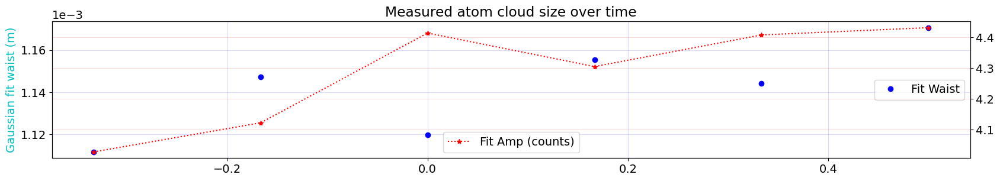

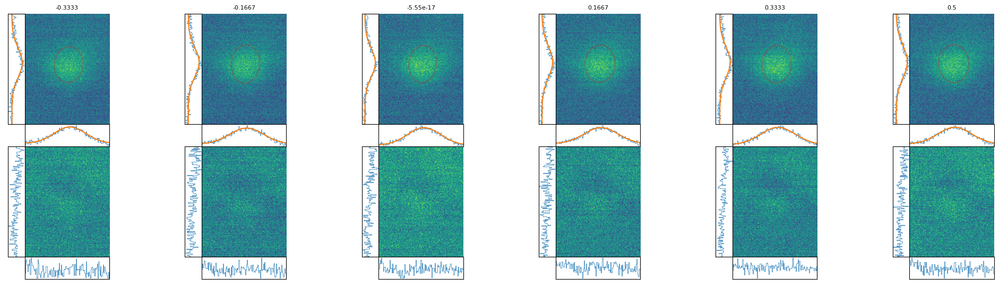

In [28]:
res = mp.plotImages(5, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

Opening Basler Images.


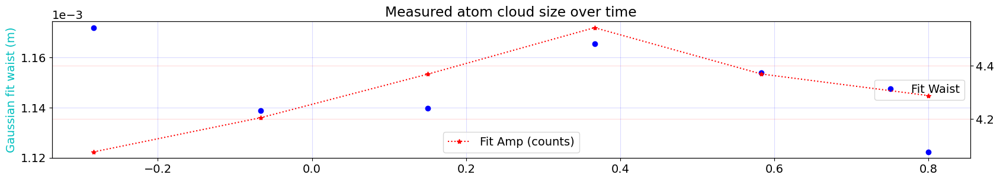

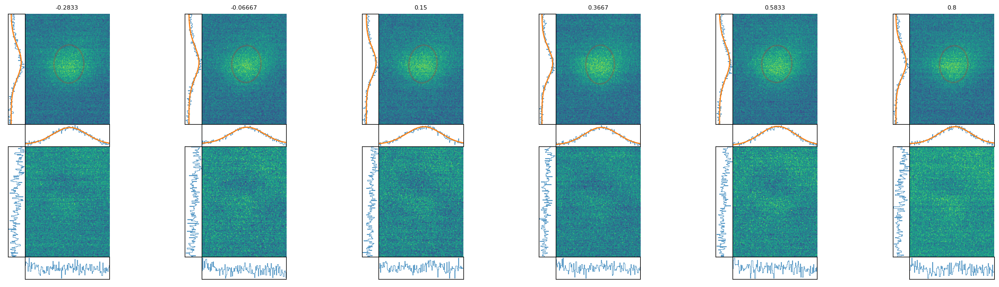

In [30]:
res = mp.plotImages(6, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Miniconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning:

Covariance of the parameters could not be estimated

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:502: UserWarning:

2D Gaussian Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

invalid value encountered in double_scalars



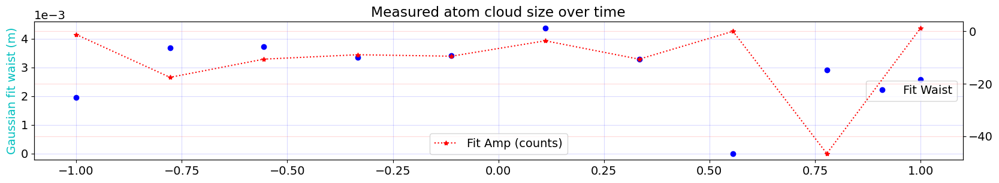

C:\Users\wdwor\Miniconda3\lib\site-packages\matplotlib\image.py:446: UserWarning:




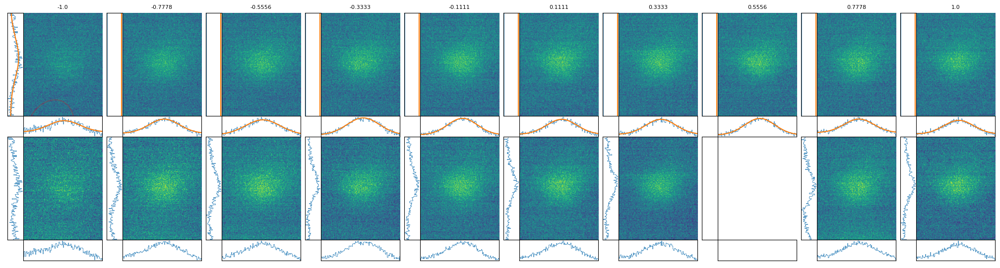

In [31]:
res = mp.plotImages(7, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:1672: DeprecationWarning:

elementwise comparison failed; this will raise an error in the future.



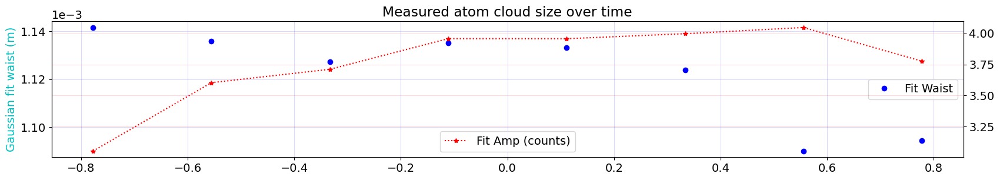

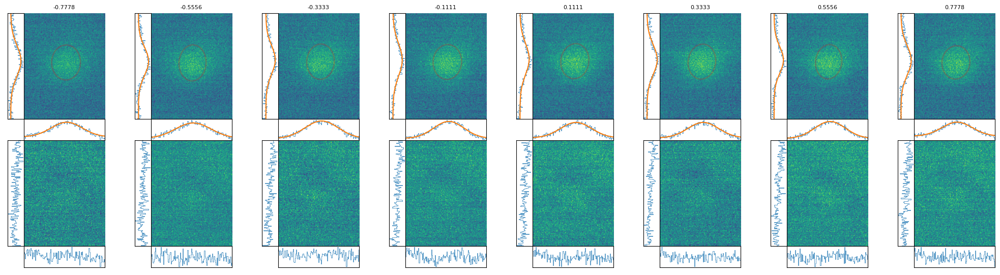

In [33]:
res = mp.plotImages(7, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60),
                   dataRange=np.arange(1,10));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


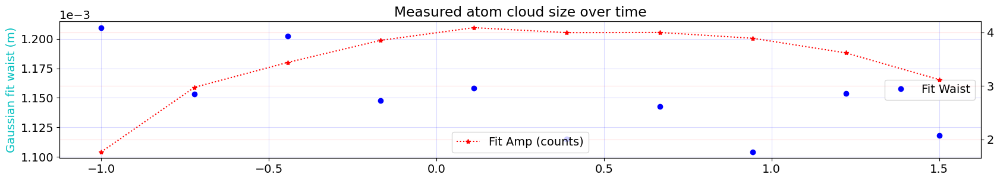

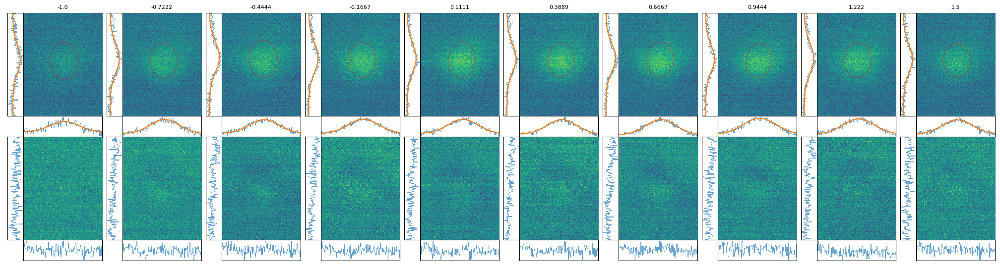

In [34]:
res = mp.plotImages(8, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### scanning MOT drop time

Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\wdwor\Miniconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning:

Covariance of the parameters could not be estimated




Temperture in the Large Laser Beam Approximation (2D Fits): 224(0) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 313(0) uK
Fit-Parameters: [ 1.40852087e-03 -8.65972443e-09  2.23677074e-04]


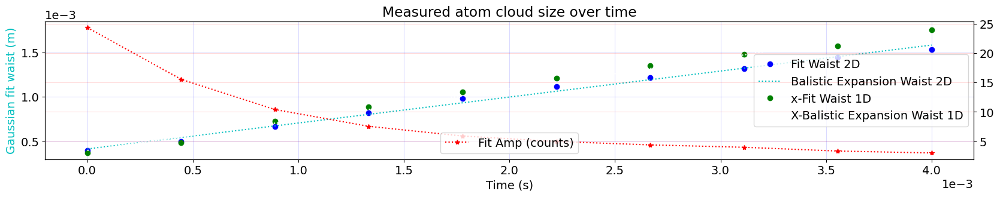

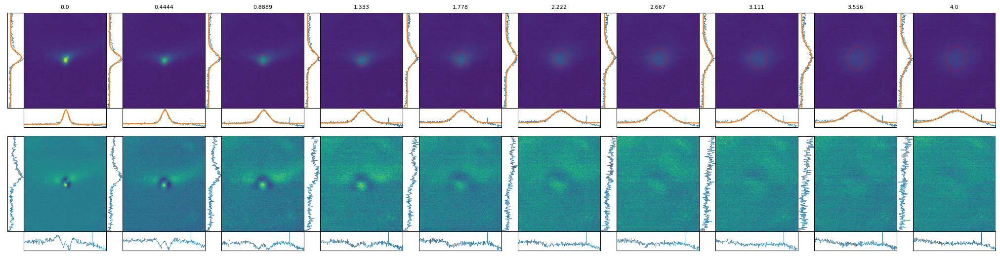

In [37]:
res = mp.plotMotTemperature(9, reps=20, fitWidthGuess=15); #window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### scannning side mot power

In [9]:
reloadMyModules(day_='23')

Opening Basler Images.


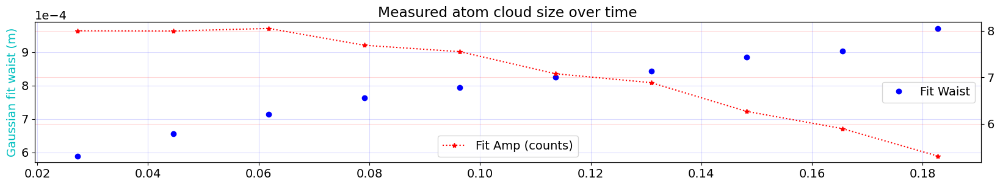

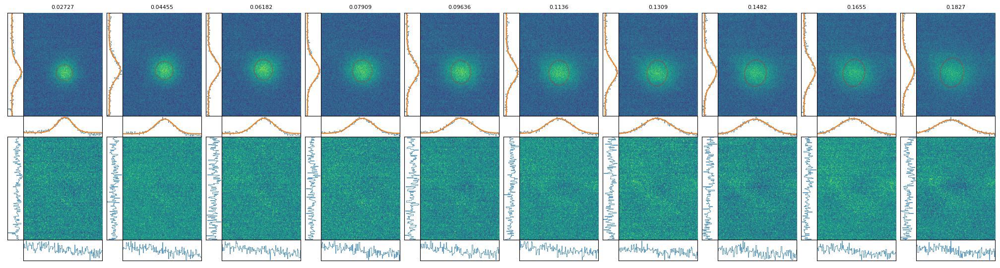

In [10]:
res = mp.plotImages(5, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


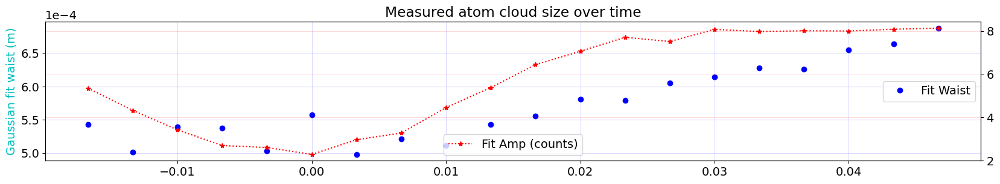

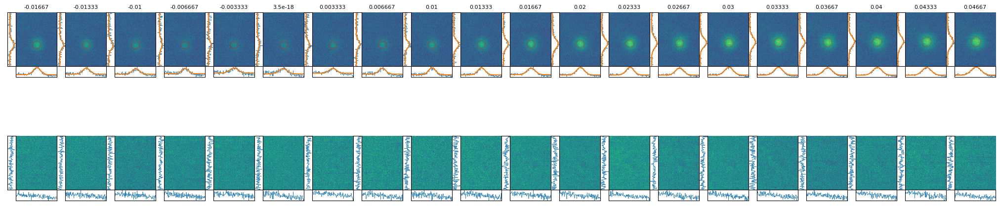

In [11]:
res = mp.plotImages(6, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### scanning drop time

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.

Temperture in the Large Laser Beam Approximation (2D Fits): 94(29) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 770(350) uK
Fit-Parameters: [2.05680952e-04 1.69242613e-04 9.39062814e-05]


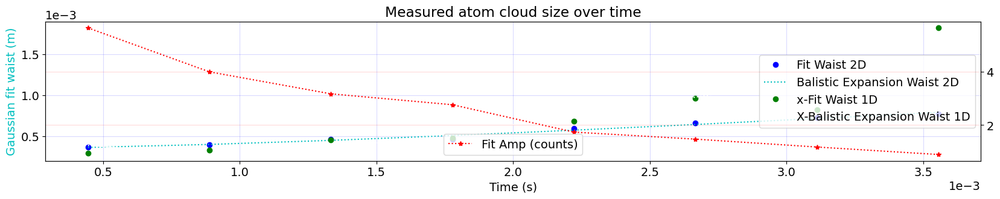

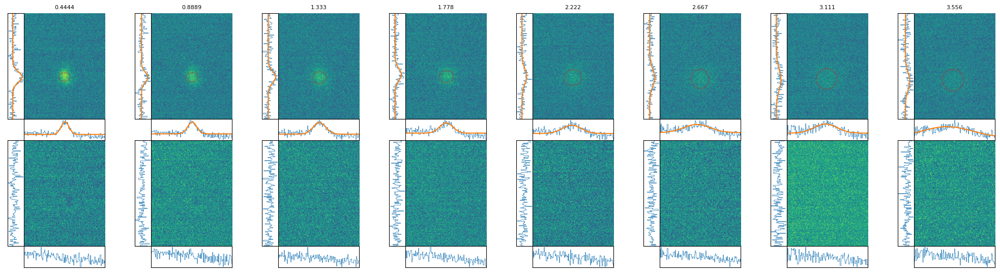

In [13]:
res = mp.plotMotTemperature(8, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.

Temperture in the Large Laser Beam Approximation (2D Fits): 87(24) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 133(41) uK
Fit-Parameters: [6.25729172e-04 1.55645737e-04 8.69712880e-05]


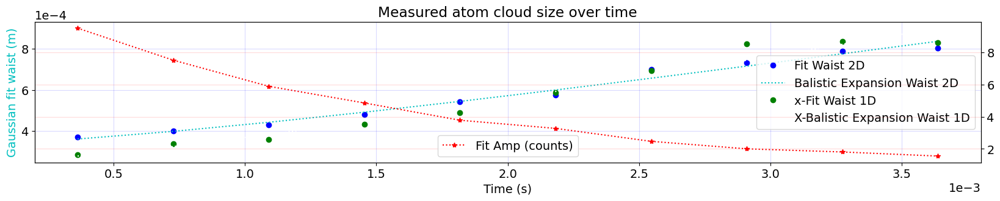

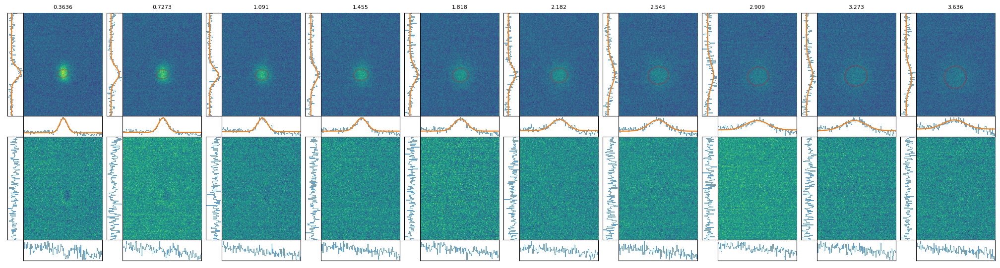

In [14]:
res = mp.plotMotTemperature(9, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:1672: DeprecationWarning:

elementwise comparison failed; this will raise an error in the future.

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:502: UserWarning:

2D Gaussian Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

invalid value encountered in double_scalars



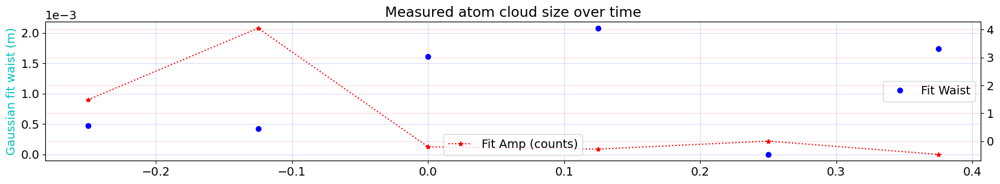

C:\Users\wdwor\Miniconda3\lib\site-packages\matplotlib\image.py:446: UserWarning:




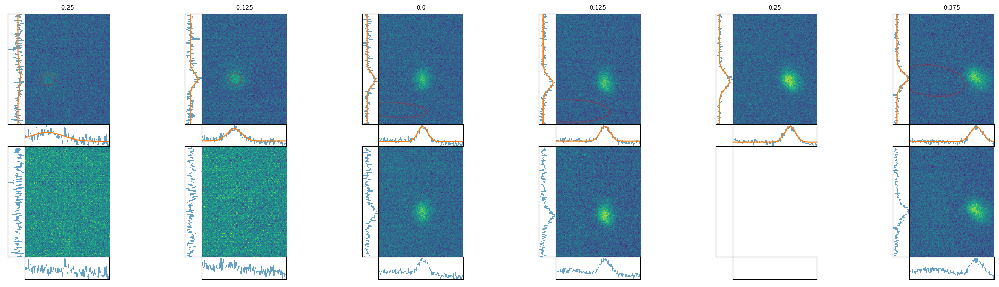

In [19]:
res = mp.plotImages(11, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60),
                   dataRange=np.arange(5,12));

#### Testing mot lasers

In [6]:
reloadMyModules(day_='24')

Opening Basler Images.


C:\Users\wdwor\Miniconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning:

Covariance of the parameters could not be estimated

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:502: UserWarning:

2D Gaussian Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

invalid value encountered in double_scalars




Temperture in the Large Laser Beam Approximation (2D Fits): 0(1200) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(45000) uK
Fit-Parameters: [4.01278032e-02 1.11548625e-06 2.46764687e-06]


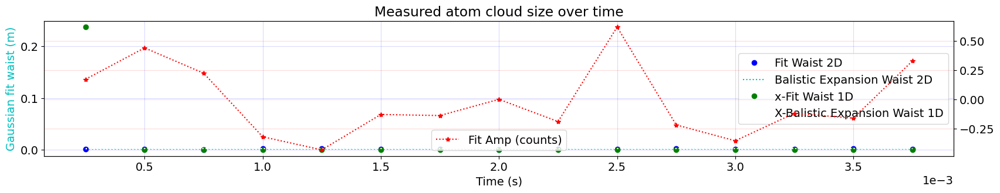

C:\Users\wdwor\Miniconda3\lib\site-packages\matplotlib\image.py:446: UserWarning:




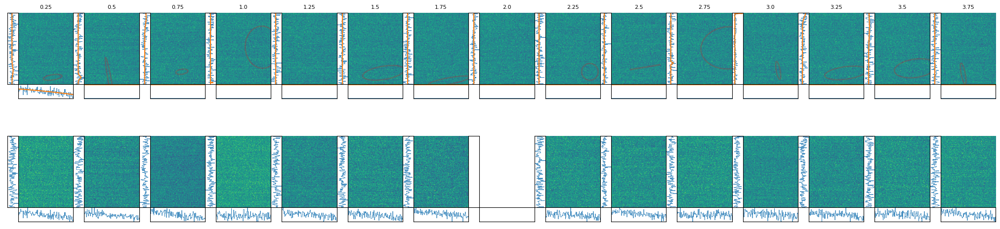

In [7]:
res = mp.plotMotTemperature(2, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

In [9]:
reloadMyModules(day_='27')

#### PGC: scanning flytime

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt




Temperture in the Large Laser Beam Approximation (2D Fits): 32.0(58) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 14.4(84) uK
Fit-Parameters: [9.23128948e-04 2.00264733e-04 3.19741158e-05]


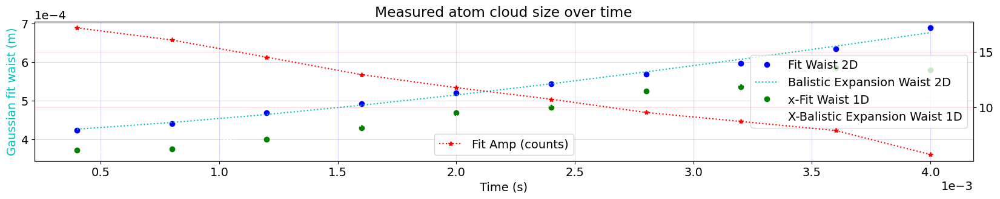

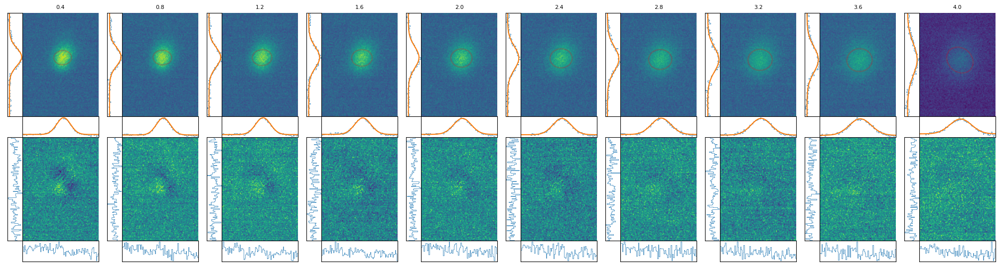

In [12]:
res = mp.plotMotTemperature(1, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### PGC: scanning flytime

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt




Temperture in the Large Laser Beam Approximation (2D Fits): 25.2(37) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 20.7(34) uK
Fit-Parameters: [1.63119841e-03 1.83106376e-04 2.52276404e-05]


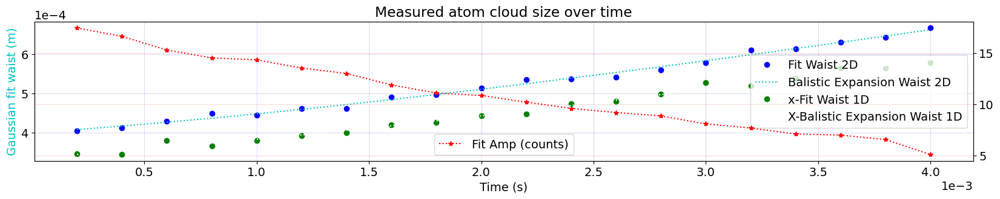

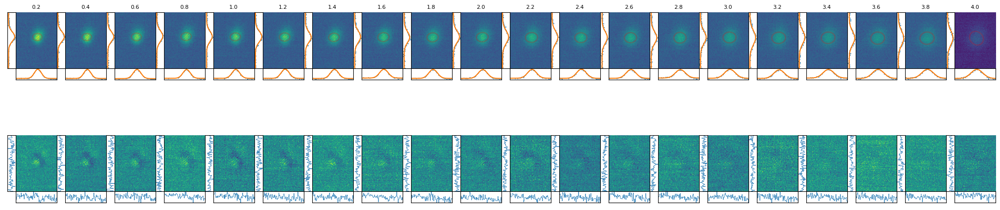

In [13]:
res = mp.plotMotTemperature(2, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### PGC: scanning pgc time

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


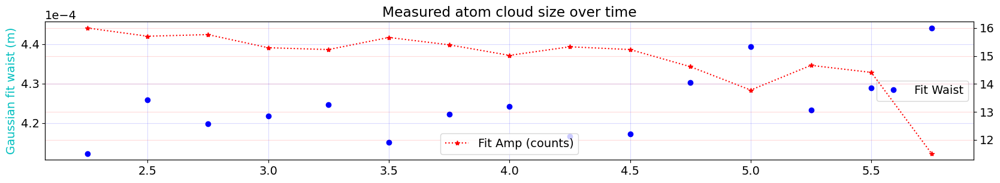

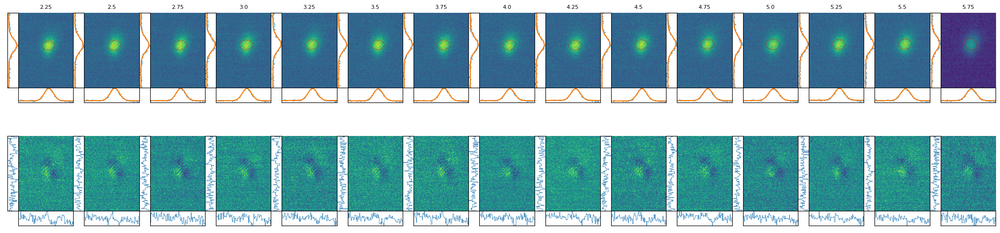

In [14]:
res = mp.plotImages(3, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt




Temperture in the Large Laser Beam Approximation (2D Fits): 0(65) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 0(42) uK
Fit-Parameters: [-1.68684247e-03  3.12383267e-04  4.41018546e-12]


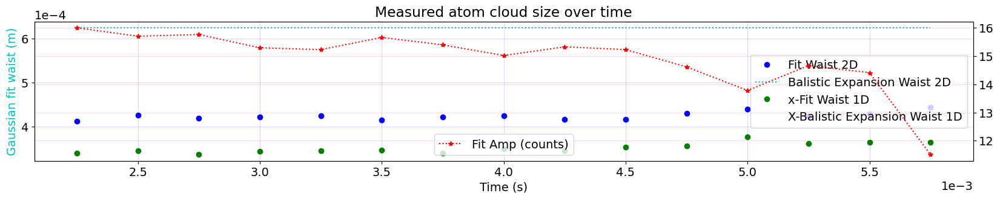

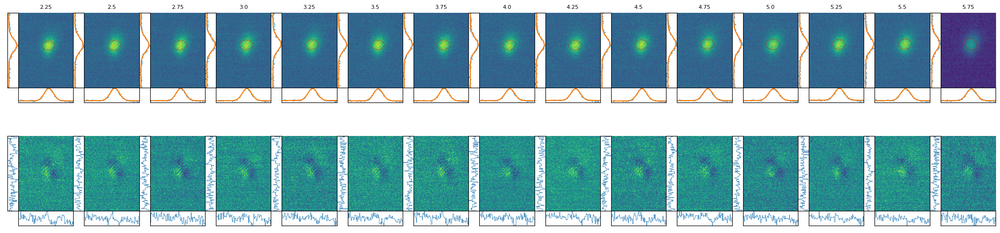

In [16]:
res = mp.plotMotTemperature(3, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### PGC: small cooling_Freq scan

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


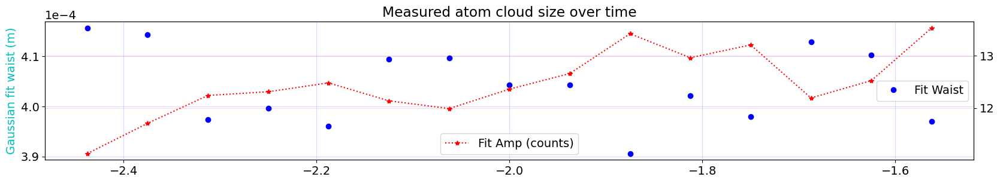

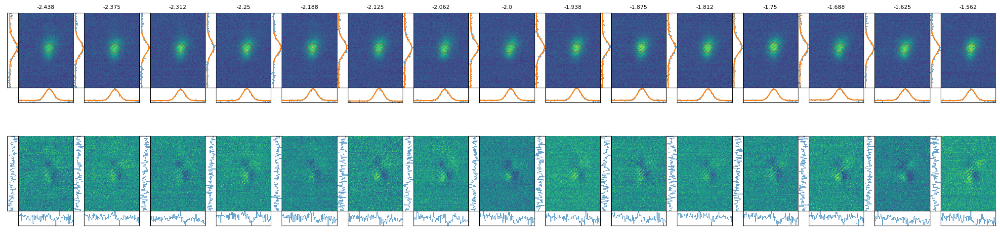

In [17]:
res = mp.plotImages(4, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

#### PGC: flytime scan 

In [6]:
reloadMyModules(day_='30')

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\LargeBeamMotExpansion.py:22: RuntimeWarning:

invalid value encountered in sqrt




Temperture in the Large Laser Beam Approximation (2D Fits): 21.2(31) uK

Temperture in the Large Laser Beam Approximation (1D Fits): 19.0(49) uK
Fit-Parameters: [1.45953726e-03 1.67788513e-04 2.11787248e-05]


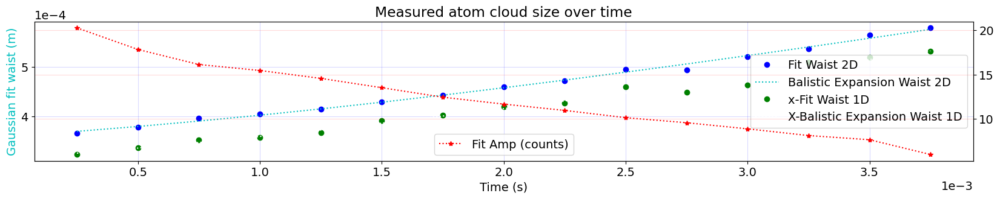

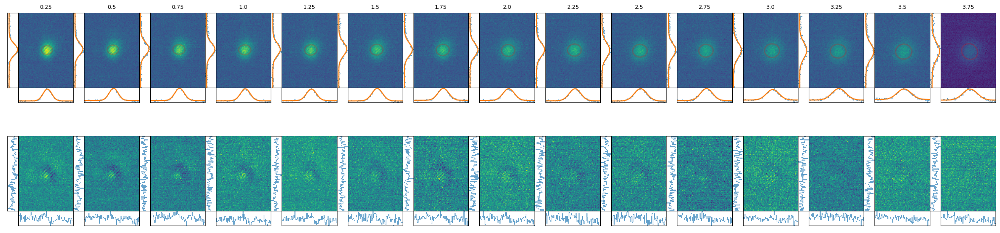

In [10]:
res = mp.plotMotTemperature(7, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


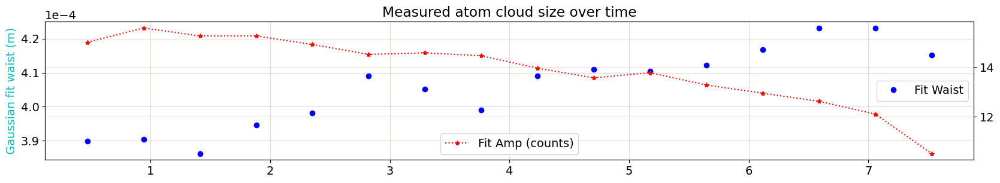

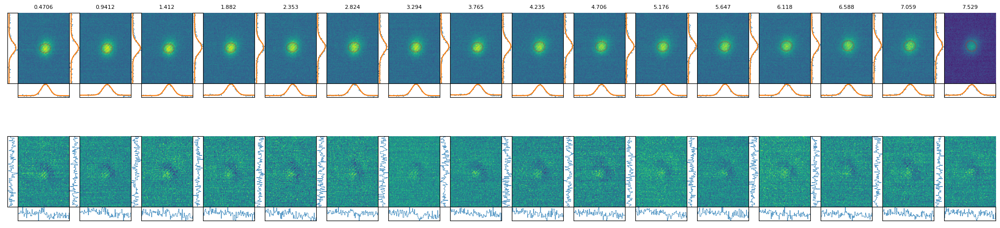

In [11]:
res = mp.plotImages(8, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


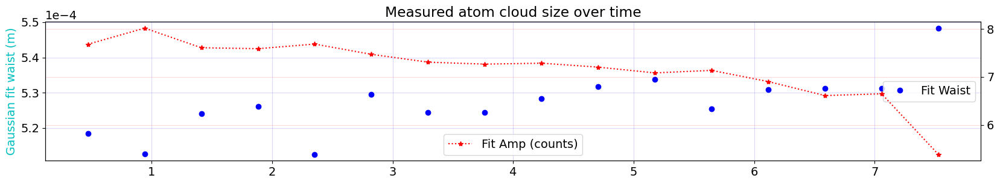

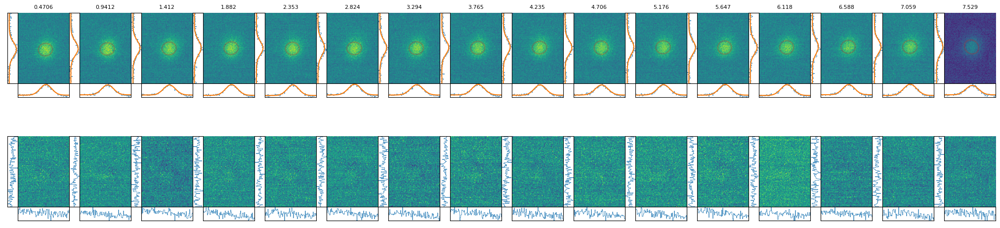

In [12]:
res = mp.plotImages(9, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


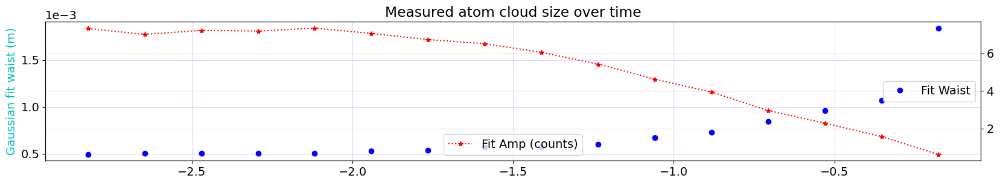

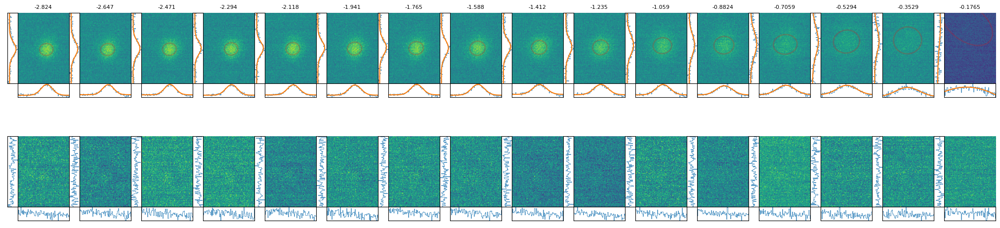

In [13]:
res = mp.plotImages(10, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


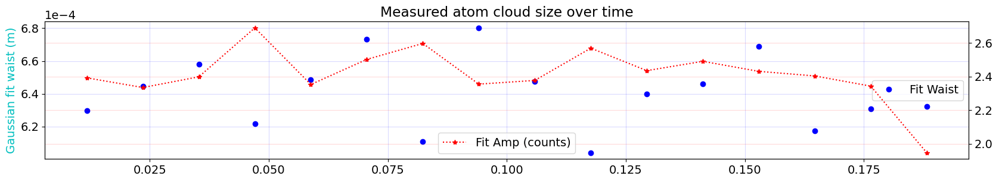

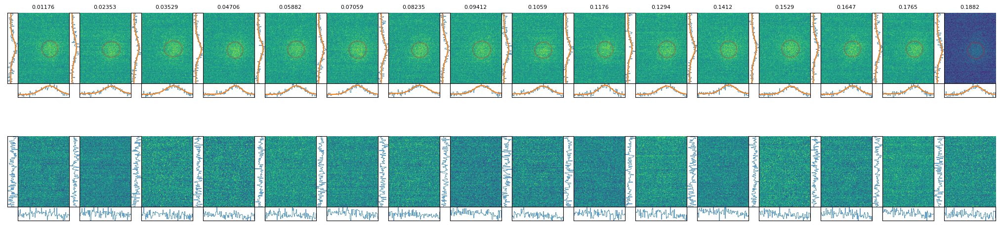

In [15]:
res = mp.plotImages(11, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


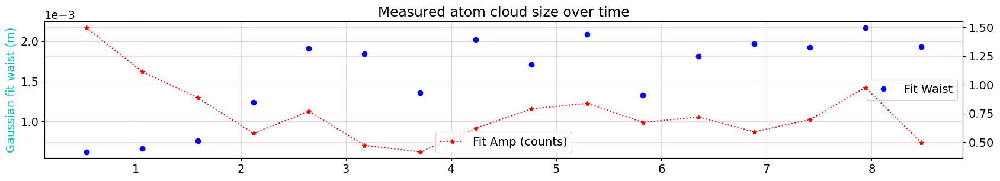

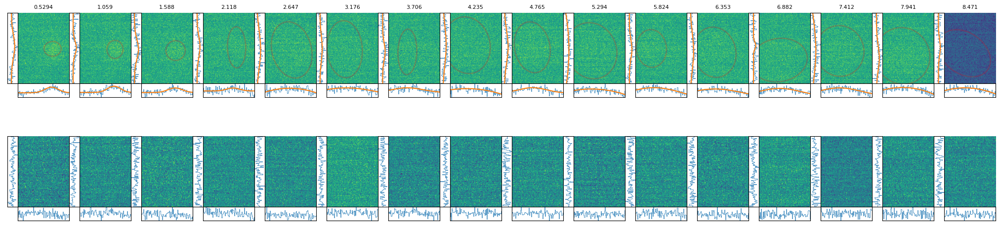

In [16]:
res = mp.plotImages(12, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));

C:\Users\wdwor\Miniconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Opening Basler Images.


C:\Users\wdwor\Miniconda3\lib\site-packages\scipy\optimize\minpack.py:828: OptimizeWarning:

Covariance of the parameters could not be estimated

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\AnalysisHelpers.py:502: UserWarning:

2D Gaussian Picture Fitting Failed!

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

invalid value encountered in double_scalars

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

divide by zero encountered in double_scalars

C:\Users\wdwor\Documents\Code\Data-Analysis-Code\Analysis_Python_Files\fitters\Gaussian\gaussian_2d.py:41: RuntimeWarning:

invalid value encountered in double_scalars



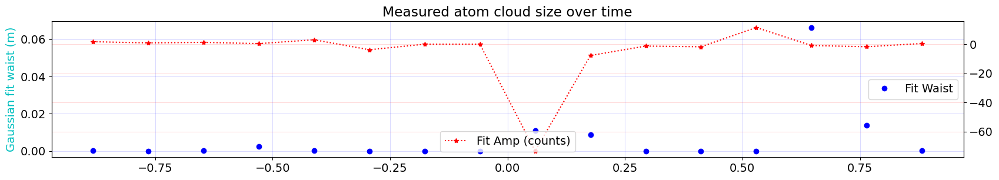

C:\Users\wdwor\Miniconda3\lib\site-packages\matplotlib\image.py:446: UserWarning:




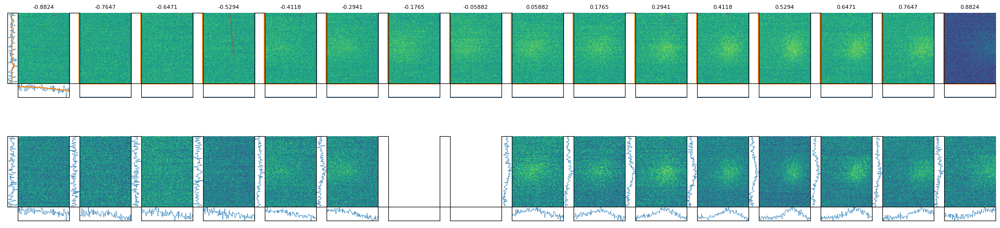

In [17]:
res = mp.plotImages(13, reps=6, fitWidthGuess=15, window=pw.PictureWindow(ymin=60, xmax=-60, ymax=-60, xmin=60));